# Assignment 2: Exploratory Data Analysis
CSCI 0465 - Aiko Hassett, Tianzhi Li (Lambus) 

In [5]:
import altair as alt
from altair.expr import datum
import pandas as pd
from vega_datasets import data as vd_data

movies = vd_data.movies()

# Defining the Big Picture 

We decided to ask these four questions:

**1. How do the rating correspond to the number of votes? This question is there to observe discrepencies between "review" and "popular opinion."**

**2. Does the rating affect how may people went to see the movie?**

**3. Does genre affect the amount of money movies make?**

**4. Which distributors have the highest total profit?**

# Question 1: IMDB Ratings vs. Votes
Our goal is to observe the relationship between the general ratings for each movie and the number of votes that contributed in making that decision. 

First we will create a scatter plot with `IMDB_Rating` in the x-axis, and `IMDB_Votes` in the y-axis to get a general overview. We added a color attribute to `Major_Genre` with the hope to gain some insight.

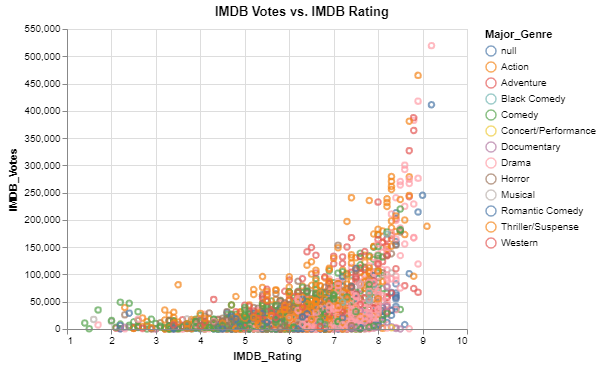

In [6]:
alt.Chart(movies).mark_point().encode(
    x = alt.X('IMDB_Rating', scale = alt.Scale(zero = False)), 
    y = alt.Y('IMDB_Votes', scale = alt.Scale(zero = False)), 
    tooltip = ['Title:N', 'Major_Genre', 'IMDB_Rating', 'IMDB_Votes'], 
    color = 'Major_Genre'
).properties(
    title = 'IMDB Votes vs. IMDB Rating'
)

The colors shown here do not seem too helpful. The movies recorded for each genre is different, so we can't quite recognize a trend relating to `Major_Genre`. 

A lot of the points seem to be concentrated at below 100,000 votes. We decided to use that to divide the plot in two.

**What if we filter the graph at above (or equal to) 100,000 votes?**

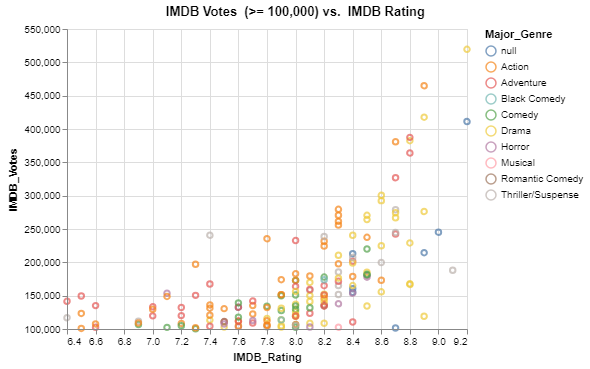

In [7]:
alt.Chart(movies).mark_point().encode(
    x = alt.X('IMDB_Rating', scale = alt.Scale(zero = False)), 
    y = alt.Y('IMDB_Votes', scale = alt.Scale(zero = False)), 
    tooltip = ['Title:N', 'Major_Genre', 'IMDB_Rating', 'IMDB_Votes'], 
    color = 'Major_Genre'
).transform_filter(
    datum.IMDB_Votes >= 100000
).properties(
    title = 'IMDB Votes  (>= 100,000) vs.  IMDB Rating'
)

**Insight:** for movies above 100,000 votes on IMDB, the movies generally have a higher rating (at least 6.4), and a positive relationship is observed between number of votes and rating. 


**What about the movies below 100,000 votes?**

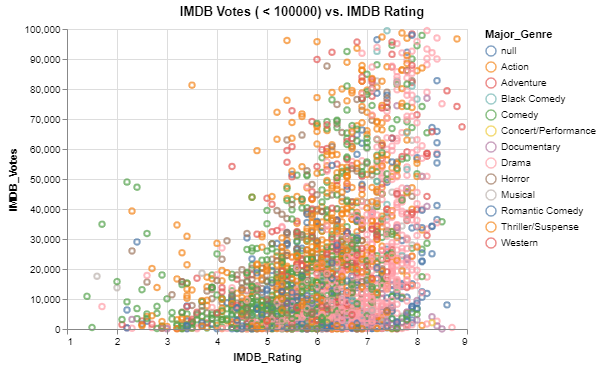

In [8]:
alt.Chart(movies).mark_point().encode(
    x = alt.X('IMDB_Rating', scale = alt.Scale(zero = False)), 
    y = alt.Y('IMDB_Votes', scale = alt.Scale(zero = False)), 
    tooltip = ['Title:N', 'Major_Genre', 'IMDB_Rating', 'IMDB_Votes'],
    color = 'Major_Genre'
).transform_filter(
    (datum.IMDB_Votes < 100000)
).properties(
    title = 'IMDB Votes ( < 100000) vs. IMDB Rating'
)

**Insight:** for movie has below 100,000 votes, the distribution of its rating is more scattered between 1 and 9, with a slight (but weaker) correlation between number of votes and ratings. 

Notice the outliers: Batman and Robin, Pearl Harbor, Epic Movie, Meet the Spartans, and Disaster Movie--all of which recved high number of votes despite their bad rating.

# Question 2: Money Generated vs. IMDB Ratings

Now let us observe whether the IMDB ratings affect the money generated from a movie. Are some movies more popular than others because they received better ratings on IMDB?

First, we will be making a scatter plot with `IMDB_Rating` on the x-axis and `US_Gross` on the y-axis. We will be using the `scale` attribute to zoom into the data as much as we can, and will also add a `tooltip` and `color` to make the data more readable.  

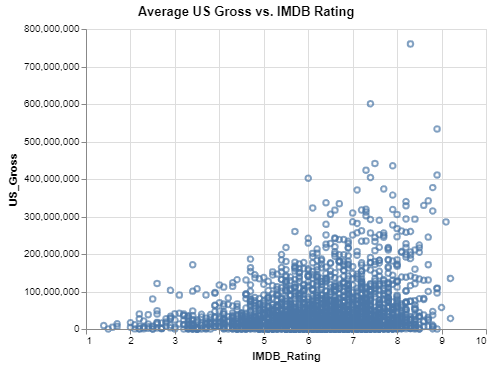

In [9]:
alt.Chart(movies).mark_point().encode(
    x = alt.X('IMDB_Rating', scale = alt.Scale(zero = False)), 
    y = alt.Y('US_Gross', scale = alt.Scale(zero = False)), 
    tooltip = ['Title:N', 'Major_Genre', 'IMDB_Rating', 'IMDB_Votes', 'US_Gross']
).properties(
    title = 'Average US Gross vs. IMDB Rating'
)

Although we wanted to describe this chart with a bar graph, we noticed that the numbers produced were wrong. (The graph shows a number a little over 22 million for movies between ratings of 6.5-7.0, but the data indicates that the mean is 33-44 million.) Therefore, we have reverted back to the scatter plot.

**What would this look like as a histogram?**

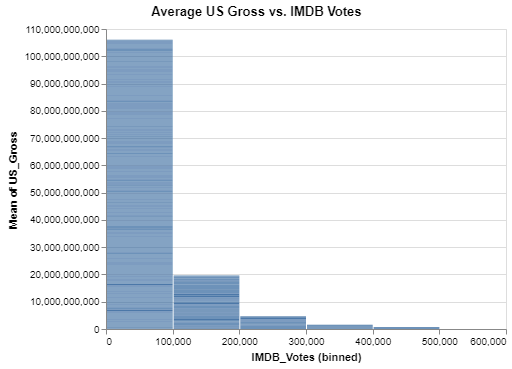

In [10]:
alt.Chart(movies).mark_bar().encode(
    x = alt.X('IMDB_Votes', scale = alt.Scale(zero = False), bin = alt.Bin(maxbins = 10)), 
    y = alt.Y('mean(US_Gross)', scale = alt.Scale(zero = False)), 
    tooltip = ['Title:N', 'Major_Genre', 'IMDB_Rating', 'IMDB_Votes', 'US_Gross']
).properties(
    title = 'Average US Gross vs. IMDB Votes'
)

**Insight:** We expected there to be higher US gross for movies that received higher number of votes. However, this graph does not imply this statement to be true. Therefore, we will investigate this matter in more detail. 

**Does the international box office (excluding gross in the US) produce similar results?**

We will first show this in terms of a scatter plot.

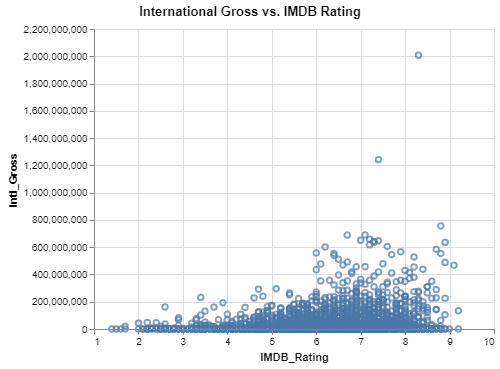

In [11]:
movies['Intl_Gross'] = movies['Worldwide_Gross'] - movies['US_Gross']
alt.Chart(movies).mark_point().encode(
    x = alt.X('IMDB_Rating', scale = alt.Scale(zero = False)), 
    y = alt.Y('Intl_Gross', scale = alt.Scale(zero = False)), 
    tooltip = ['Title:N', 'Major_Genre', 'IMDB_Rating', 'IMDB_Votes', 'Production_Budget', 'Worldwide_Gross', 'Intl_Gross'], 
).properties(
    title = 'International Gross vs. IMDB Rating'
)

**Insight:** The trends are more or less similar to the US_Gross vs. IMDB_Votes plot.

**Are there any relationships between international gross and IMDB votes?**

We again used a scatter plot.

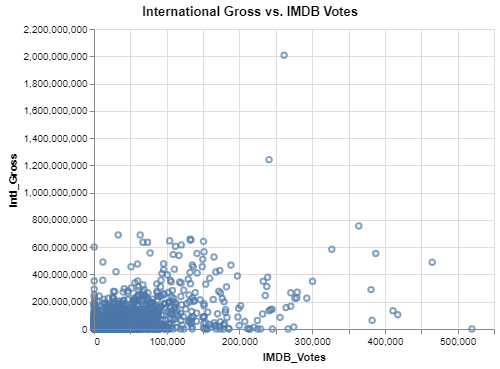

In [12]:
movies['Intl_Gross'] = movies['Worldwide_Gross'] - movies['US_Gross']
alt.Chart(movies).mark_point().encode(
    x = alt.X('IMDB_Votes', scale = alt.Scale(zero = False)), 
    y = alt.Y('Intl_Gross', scale = alt.Scale(zero = False)), 
    tooltip = ['Title:N', 'Major_Genre', 'IMDB_Rating', 'IMDB_Votes', 'Production_Budget', 'Worldwide_Gross', 'Intl_Gross'] 
).properties(
    title = 'International Gross vs. IMDB Votes'
)

**Insight:** This plot pointed our attention to some significant outliers such as Titanic and Avatar. These are both well-known films, and the plot clearly indicates their success in comparison to most movies that recieved lower or equal numbers of votes on IMDB. The Shawshank Redemption is an interesting case. Whereas the movie received a large number of votes, it barely produced profit internationally. This may be because the movie is old and was perhaps mostly distributed in the US. 


# Quesion 3: Profit vs. Genre

We will first compare the worldwide gross for each movie genre to observe any relationships.  

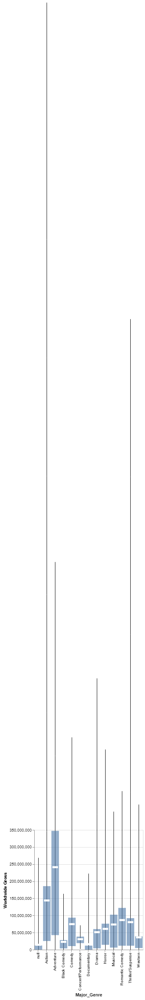

In [13]:
whiskers_G = alt.Chart(movies).mark_rule().encode(
    x = alt.X('Major_Genre'), 
    y = alt.Y('min(Worldwide_Gross)', scale=alt.Scale(domain=(0, 50000000)), axis = alt.Axis(title='Worldwide Gross')), 
    y2 = alt.Y2('max(Worldwide_Gross)'), 
    )
box_G = alt.Chart(movies).mark_bar(opacity = 0.6).encode(
x = 'Major_Genre', y= 'q1(Worldwide_Gross)', y2 = 'q3(Worldwide_Gross)'
)

ticks_G = alt.Chart(movies).mark_tick(color='white', thickness = 5).encode(
    x = 'Major_Genre', y = 'mean(Worldwide_Gross)'
)

chart_G = whiskers_G + box_G + ticks_G
chart_G

**Insight:** From the data shown, we can see that the box for Adventure films had the widest range. This tells us that it is possibly more unpredictable to gage the profit of the movie produced. We also noticed that there seemed to be a smaller popularity for genres such as black comedy and documentary. 

Especially for documentaries, we noticed that the mean value was above the third quartile value. This tells us that a very small number of documentaries have dominated the genre.

We also focus on the outliers. The two most siginificant outliers are Action and Thriller/Suspense. This is reasonable considering that they are the two very popular genres in cinema.

**Analyzing from the perspective of a film producer who tries to decide on the financial factors of the film, how would production budget and genre map onto each other?**

We will make another box and whiskers graph for this. 

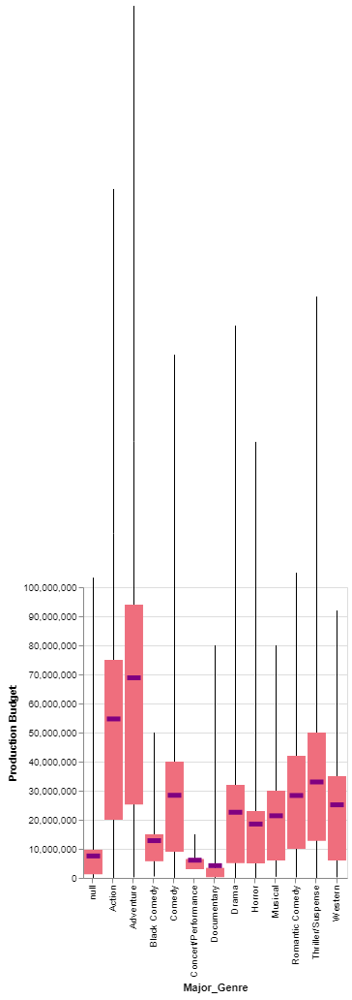

In [14]:
whiskers_B = alt.Chart(movies).mark_rule().encode(
    x = alt.X('Major_Genre'), 
    y = alt.Y('min(Production_Budget)', scale=alt.Scale(domain=(0, 50000000)), axis = alt.Axis(title='Production Budget')), 
    y2 = alt.Y2('max(Production_Budget)'), 
    )

box_B = alt.Chart(movies).mark_bar(color = '#EF6E7D').encode(
x = 'Major_Genre', y= 'q1(Production_Budget)', y2 = 'q3(Production_Budget)'
)

ticks_B = alt.Chart(movies).mark_tick(color='purple', thickness = 5).encode(
    x = 'Major_Genre', y = 'mean(Production_Budget)'
)

chart_B = whiskers_B + box_B + ticks_B
chart_B

Now we would like to combine the box and whiskers graph created earlier (in blue: Worldwide gross vs. Major Genre) to this new one (in pink: Production cost vs. Major Genre).

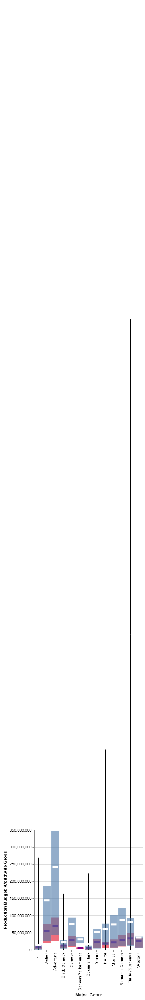

In [15]:
chart_B + chart_G

**Insight:** First, it appears as if there is a high guarantee of profitability for ocncert and performances despite its relatively low return. This may be due to the fact that concerts do not require a high cost for cinematography, which is suffered by other genres especially action and adventure films. 
    
Secondly, the majortiy of western films have nearly no profitability accoridng to this graph. We may bear in mind a question why westerns films are produced in the first place. Our conjecture is that the directors of western films do not aim for profit, but for conserving this dying genre due to the rise of action and adventure films. 

Last but not least, action and adventure films earn the most amount of profit, but also marking a notably higher production cost than the others. 

**The chart created above does not reflect the risk of losing money for each genre. How could we go about analyzing something like that?**

For the risk analysis of each genre, we define: 

*risk rate = (number of movies with loss) / (total number of movies)*

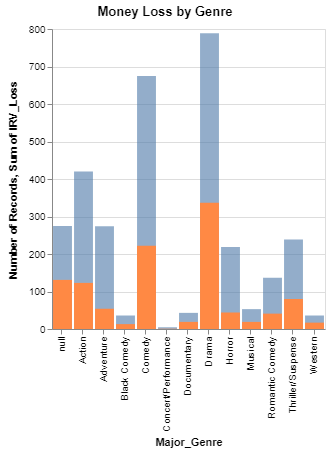

In [16]:
movies['exp_profit'] = movies['Worldwide_Gross'] - movies['Production_Budget']
movies['IRV_Loss'] = (movies['exp_profit'] < 0).astype(int)

total_chart = alt.Chart(movies).mark_bar(opacity = 0.6).encode(
    x = alt.X('Major_Genre'), 
    y = alt.Y('count()')
).properties(title='Money Loss by Genre')

loss_chart = alt.Chart(movies).mark_bar(color = '#FF8944').encode(
    x = alt.X('Major_Genre'), 
    y = alt.Y('sum(IRV_Loss)')
)

total_chart + loss_chart

Here the bar graph shows the total number of movies for each genre in blue, and the cases where money was lost in orange. 

We did not manage to figure a way to manipulate the data in order to give us a concrete risk rate, thus we found an alternative way to "visualize" such a rate without knowing the value as we did above. 

**Insight:** However, this visualization clearly indicates that adventure films have the smallest risk rate despite its high return rate. This explains why adventure films are popular commercially. 

Very interestingly, drama had the highest risk rate. Our speculation is that there may be a divide between those who are well-funded and experienced in the field and those who are new-comers into the film industry. 

# Question 4: Distributors vs. Profit

We initially wanted to create a layered series of pie charts showing the worldwide gross for each distributor, but we couldn't find a way to make one so we settled for a bar graph representation.

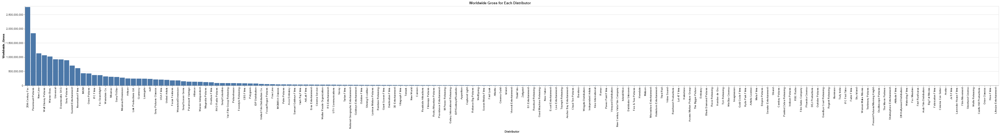

In [17]:
alt.Chart(movies).mark_bar().encode(
    x = alt.X('Distributor', 
              sort = alt.EncodingSortField(field='Worldwide_Gross', op='max', order='descending')
             ),
    y = alt.Y('Worldwide_Gross')
).properties(title='Worldwide Gross for Each Distributor')

**Insight:** We noticed that 20th Centry Fox was by far the largest distributor for these films with approimately a 50% lead from Paramount Pictures which comes in second. 20th Century Fox and Paramount Pictures are at a large lead compared to the other distributors which have more similar amount of profit. 

------------------------------------------------------------------------------------------------------------
# A Summary of Insights

**Insight 1: Ratings vs Votes** For movies with high votes (above 100,000), there is a positive correlation between number of votes and ratings. In contrast, movies with below 100,000 votes have wide range of rating between 1 to 9, and have a weaker correlation between number of votes and ratings. 

**Insight 2: Gross vs votes** The movies with higher gross (both US and international) does not necessarily have higher votes. 

**Insight 3: Profitability vs genre** Adventure film is the most profitable genres with relatively low risk, while drama has the highest risk rate. However, each genres faces very different situations. 

**Insight 4: Industry structure** Film making is an oligopolist industry, dominate by a small number of distributors such as 20th Century Fox and Paramount Pictures. 